In [5]:
import numpy as np
import matplotlib.pyplot as plt
import time

In [ ]:
# numerical parameters
dt = 0.001  # s
ntmax = int(1e6)

NSample = 1  # number of samples

# model parameters
D = 10  # microns^2/second
L = 10  # microns
NPCSize = 0.1  # microns
NPCLocation = np.array([-L/2, 0])

alpha = np.sqrt(2*D*dt)

# data collection
tCapture = np.zeros(NSample)

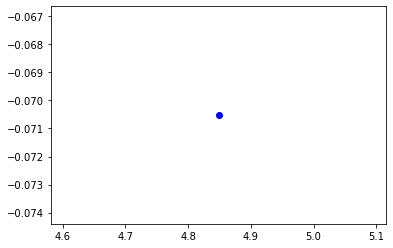

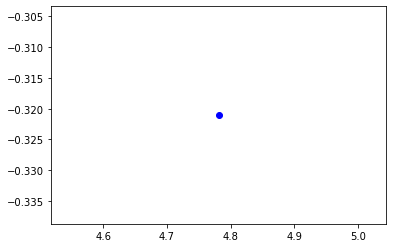

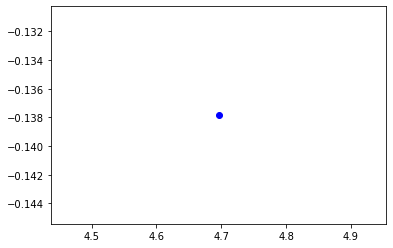

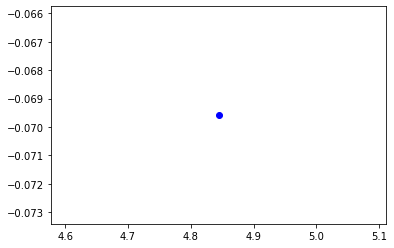

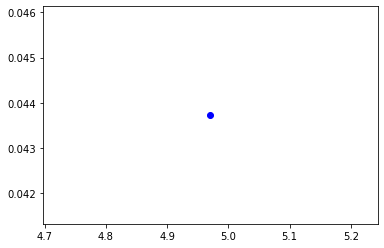

...

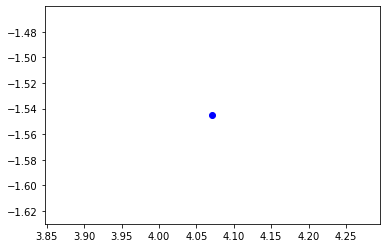

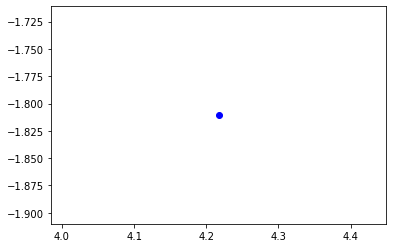

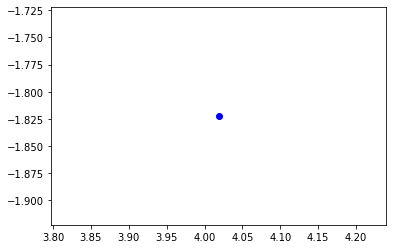

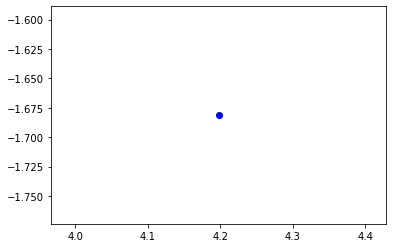

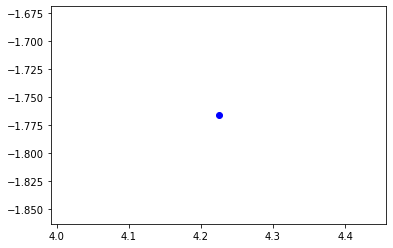

In [ ]:
# set up figure
plt.figure(1)
plt.xlabel('x (um)')
plt.ylabel('y (um)')
plt.xlim(-L/2, L/2)
plt.ylim(-L/2, L/2)
plt.plot(NPCLocation[0], NPCLocation[1], 'or', markersize=10)

# Simulate!
start = time.time()

for iSample in range(NSample):
    # initial condition
    x = np.array([L/2, 0])
    
    t = 0
    for nt in range(ntmax):
        # dynamics
        x = x + alpha*np.random.randn(2)
        
        # boundaries
        x = np.clip(x, -L/2, L/2)
        
        # test for NPC capture
        if np.sum((x - NPCLocation)**2) < NPCSize**2:
            tCapture[iSample] = t
            break
        
        t += dt

        # visualize
        plt.plot(x[0], x[1], '-ob')
        plt.draw()
        plt.pause(0.001)  # add a short pause for the plot to update
        

    print('Sample %d: tCapture = %f' % (iSample, tCapture[iSample]))

end = time.time()
print("Elapsed time: ", end - start)

# analyze results
plt.figure(2)
plt.hist(tCapture, bins='auto')
plt.show()